In [ ]:
'''
모델
 - OLS (Ordinary Least Squares)
 - LinearRegression
 - 의사결정나무
 - SVM
 - 랜덤포레스트
 - 인공신경망

모델 결정을 위한 함수
 - mean_squared_error : 평균제곱근오차 함수
 - cross_val_score : 교차검증
 - GridSearchCV : 파라미터 튜닝
 - RandomizedSearchCV : 파라미터 최적화 함수
'''

# 데이터 불러오기

In [1]:
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np

# 그래프에서 마이너스 폰트 깨지는 문제에 대한 대처
mpl.rcParams['axes.unicode_minus'] = False

# 폰트 지정하기
plt.rcParams['font.family'] = 'gulim'

In [2]:
df = pd.read_csv("./csv/preprocess.csv")
df.head()

,overall_rating,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,...,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,preferred_foot_left,preferred_foot_right
0,67.0,71.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,...,71.0,70.0,45.0,54.0,48.0,65.0,69.0,69.0,0,1
1,67.0,71.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,...,71.0,70.0,45.0,54.0,48.0,65.0,69.0,69.0,0,1
2,62.0,66.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,...,63.0,41.0,45.0,54.0,48.0,65.0,66.0,69.0,0,1
3,61.0,65.0,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,...,62.0,40.0,44.0,53.0,47.0,62.0,63.0,66.0,0,1
4,61.0,65.0,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,...,62.0,40.0,44.0,53.0,47.0,62.0,63.0,66.0,0,1


# 분석

In [3]:
dfX = df.iloc[:, 1:]
dfy = df.iloc[:, 0]

In [4]:
dfX

,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,...,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,preferred_foot_left,preferred_foot_right
0,71.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,...,71.0,70.0,45.0,54.0,48.0,65.0,69.0,69.0,0,1
1,71.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,...,71.0,70.0,45.0,54.0,48.0,65.0,69.0,69.0,0,1
2,66.0,49.0,44.0,71.0,61.0,44.0,51.0,45.0,39.0,64.0,...,63.0,41.0,45.0,54.0,48.0,65.0,66.0,69.0,0,1
3,65.0,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,63.0,...,62.0,40.0,44.0,53.0,47.0,62.0,63.0,66.0,0,1
4,65.0,48.0,43.0,70.0,60.0,43.0,50.0,44.0,38.0,63.0,...,62.0,40.0,44.0,53.0,47.0,62.0,63.0,66.0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
165487,85.0,84.0,77.0,59.0,89.0,77.0,84.0,86.0,78.0,84.0,...,56.0,78.0,86.0,88.0,83.0,22.0,31.0,30.0,0,1
165488,80.0,74.0,76.0,53.0,84.0,77.0,85.0,86.0,74.0,73.0,...,61.0,64.0,72.0,88.0,70.0,32.0,31.0,30.0,0,1
165489,80.0,74.0,71.0,53.0,84.0,77.0,85.0,86.0,74.0,73.0,...,67.0,64.0,72.0,88.0,70.0,32.0,31.0,30.0,0,1
165490,81.0,74.0,64.0,57.0,86.0,77.0,87.0,86.0,73.0,73.0,...,63.0,63.0,68.0,88.0,53.0,28.0,32.0,30.0,0,1


In [5]:
dfX.columns

Index(['potential', 'crossing', 'finishing', 'heading_accuracy',
       'short_passing', 'volleys', 'dribbling', 'curve', 'free_kick_accuracy',
       'long_passing', 'ball_control', 'acceleration', 'sprint_speed',
       'agility', 'reactions', 'balance', 'shot_power', 'jumping', 'stamina',
       'strength', 'long_shots', 'aggression', 'interceptions', 'positioning',
       'vision', 'penalties', 'marking', 'standing_tackle', 'sliding_tackle',
       'preferred_foot_left', 'preferred_foot_right'],
      dtype='object')

In [6]:
from sklearn.model_selection import train_test_split
import statsmodels.api as sm

dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:         overall_rating   R-squared:                       0.853
Model:                            OLS   Adj. R-squared:                  0.853
Method:                 Least Squares   F-statistic:                 2.556e+04
Date:                Wed, 05 Apr 2023   Prob (F-statistic):               0.00
Time:                        12:53:38   Log-Likelihood:            -3.1813e+05
No. Observations:              132393   AIC:                         6.363e+05
Df Residuals:                  132362   BIC:                         6.366e+05
Df Model:                          30                                         
Covariance Type:            nonrobust                                         
========================================================================================
                           coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------
potential                0.3323      0.002    199.929      0.000       0.329       0.336
crossing                 0.0187      0.001     20.323      0.000       0.017       0.021
finishing                0.0181      0.001     17.930      0.000       0.016       0.020
heading_accuracy         0.0827      0.001     88.714      0.000       0.081       0.084
short_passing            0.0518      0.002     30.482      0.000       0.048       0.055
volleys                  0.0005      0.001      0.530      0.596      -0.001       0.002
dribbling               -0.0046      0.001     -3.519      0.000      -0.007      -0.002
curve                    0.0114      0.001     13.003      0.000       0.010       0.013
free_kick_accuracy       0.0096      0.001     12.063      0.000       0.008       0.011
long_passing             0.0183      0.001     14.978      0.000       0.016       0.021
ball_control             0.1525      0.002     82.546      0.000       0.149       0.156
acceleration             0.0165      0.002     10.188      0.000       0.013       0.020
sprint_speed             0.0100      0.002      6.585      0.000       0.007       0.013
agility                 -0.0107      0.001     -8.918      0.000      -0.013      -0.008
reactions                0.2123      0.001    164.286      0.000       0.210       0.215
balance                  0.0141      0.001     15.493      0.000       0.012       0.016
shot_power               0.0227      0.001     22.478      0.000       0.021       0.025
jumping                  0.0099      0.001     12.073      0.000       0.008       0.011
stamina                 -0.0038      0.001     -4.042      0.000      -0.006      -0.002
strength                 0.0630      0.001     63.725      0.000       0.061       0.065
long_shots              -0.0192      0.001    -18.964      0.000      -0.021      -0.017
aggression               0.0189      0.001     23.612      0.000       0.017       0.020
interceptions            0.0087      0.001     10.897      0.000       0.007       0.010
positioning             -0.0140      0.001    -15.812      0.000      -0.016      -0.012
vision                  -0.0150      0.001    -14.478      0.000      -0.017      -0.013
penalties                0.0190      0.001     22.097      0.000       0.017       0.021
marking                  0.0363      0.001     29.398      0.000       0.034       0.039
standing_tackle          0.0141      0.001      9.931      0.000       0.011       0.017
sliding_tackle          -0.0368      0.001    -30.012      0.000      -0.039      -0.034
preferred_foot_left     -1.3154      0.106    -12.358      0.000      -1.524      -1.107
preferred_foot_right    -1.3105      0.106    -12.383      0.000      -1.518      -1.103
=========================================================

In [ ]:
# 다중공선성 의심

## 다중공선성 해결

In [7]:
import seaborn as sns

In [8]:
sns.pairplot(dfX.iloc[:, :-2])
plt.show()

In [8]:
dfX.corr()

,potential,crossing,finishing,heading_accuracy,short_passing,volleys,dribbling,curve,free_kick_accuracy,long_passing,...,aggression,interceptions,positioning,vision,penalties,marking,standing_tackle,sliding_tackle,preferred_foot_left,preferred_foot_right
potential,1.000000,0.341519,0.325436,0.259130,0.537782,0.349010,0.448505,0.354403,0.299672,0.388488,...,0.159765,0.159360,0.386442,0.437380,0.348205,0.044247,0.075602,0.055368,-0.004238,0.004238
crossing,0.341519,1.000000,0.385467,-0.130396,0.643289,0.462914,0.669409,0.672843,0.580531,0.589117,...,0.060603,0.084255,0.517148,0.580048,0.401453,-0.029914,0.007748,0.014010,0.163002,-0.163002
finishing,0.325436,0.385467,1.000000,0.037107,0.377812,0.802412,0.700935,0.570460,0.508556,0.127811,...,-0.245482,-0.448604,0.740622,0.557278,0.660646,-0.621140,-0.586244,-0.605245,-0.063363,0.063363
heading_accuracy,0.259130,-0.130396,0.037107,1.000000,0.101541,0.039696,-0.141167,-0.141657,-0.093802,0.026561,...,0.434009,0.281521,0.019068,-0.041213,0.140270,0.275851,0.270093,0.232907,-0.074260,0.074260
short_passing,0.537782,0.643289,0.377812,0.101541,1.000000,0.453751,0.605029,0.574341,0.559998,0.799419,...,0.218186,0.241510,0.497074,0.704284,0.451293,0.100607,0.165094,0.131143,0.019408,-0.019408
volleys,0.349010,0.462914,0.802412,0.039696,0.453751,1.000000,0.686777,0.645988,0.568086,0.235945,...,-0.148241,-0.312953,0.704273,0.609649,0.647604,-0.495964,-0.449936,-0.458077,-0.039048,0.039048
dribbling,0.448505,0.669409,0.700935,-0.141167,0.605029,0.686777,1.000000,0.701088,0.570972,0.404117,...,-0.165176,-0.242323,0.694795,0.637514,0.531720,-0.406710,-0.357519,-0.363608,0.039391,-0.039391
curve,0.354403,0.672843,0.570460,-0.141657,0.574341,0.645988,0.701088,1.000000,0.721264,0.468333,...,-0.078511,-0.115307,0.600283,0.651037,0.543511,-0.270280,-0.220938,-0.222946,0.102005,-0.102005
free_kick_accuracy,0.299672,0.580531,0.508556,-0.093802,0.559998,0.568086,0.570972,0.721264,1.000000,0.503687,...,-0.002375,-0.035603,0.524304,0.620472,0.578654,-0.177703,-0.127639,-0.147638,0.099899,-0.099899
long_passing,0.388488,0.589117,0.127811,0.026561,0.799419,0.235945,0.404117,0.468333,0.503687,1.000000,...,0.304617,0.415743,0.268422,0.576156,0.267335,0.323481,0.378126,0.353235,0.071046,-0.071046


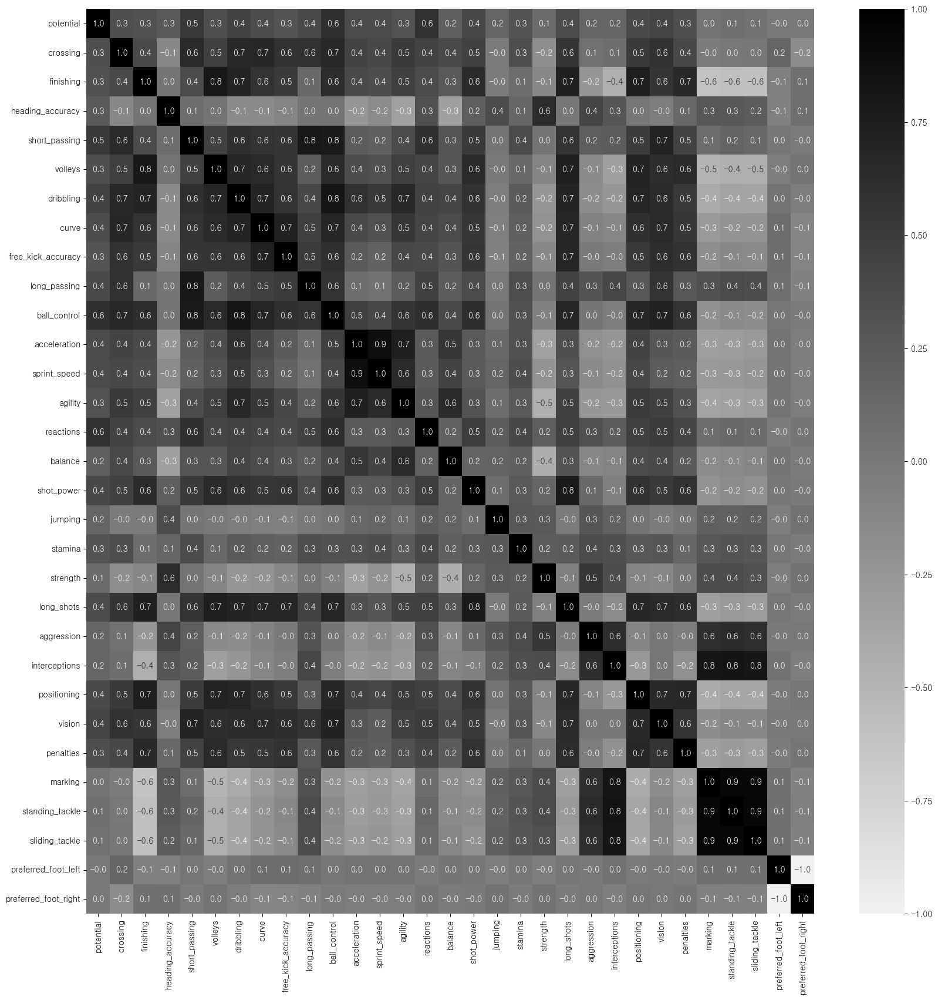

In [9]:
%matplotlib inline
plt.figure(figsize=(20,20))
cmap = sns.light_palette("black", as_cmap=True)
sns.heatmap(dfX.corr(), annot=True, fmt='3.1f', cmap=cmap)
plt.show()

In [10]:
# 높은 상관계수 프린트
df_corr = dfX.corr()
columns = df_corr.columns

for i in range(len(columns)):
    for j in range(len(columns)):
        if df_corr.iloc[i, j] > 0.80:
            if columns[i] != columns[j]:
                print(columns[i], "&", columns[j], ":", df_corr.iloc[i, j])

finishing & volleys : 0.8024116145505796
volleys & finishing : 0.8024116145505796
dribbling & ball_control : 0.8232721195527889
ball_control & dribbling : 0.8232721195527889
acceleration & sprint_speed : 0.8808380374570741
sprint_speed & acceleration : 0.8808380374570741
interceptions & marking : 0.8204307486406518
interceptions & standing_tackle : 0.8339564952016908
interceptions & sliding_tackle : 0.8128604437759714
marking & interceptions : 0.8204307486406518
marking & standing_tackle : 0.9423168475477287
marking & sliding_tackle : 0.9288922520999666
standing_tackle & interceptions : 0.8339564952016908
standing_tackle & marking : 0.9423168475477287
standing_tackle & sliding_tackle : 0.9460726749758973
sliding_tackle & interceptions : 0.8128604437759714
sliding_tackle & marking : 0.9288922520999666
sliding_tackle & standing_tackle : 0.9460726749758973


In [11]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(
    dfX.values, i) for i in range(dfX.shape[1])]
vif["features"] = dfX.columns
vif = vif.sort_values("VIF Factor").reset_index(drop=True)
vif

,VIF Factor,features
0,1.521035,jumping
1,1.826109,stamina
2,2.188490,potential
3,2.188757,balance
4,2.415870,aggression
5,2.432064,heading_accuracy
6,2.433713,reactions
7,2.509721,penalties
8,2.634439,strength
9,2.865210,free_kick_accuracy


In [12]:
# 의존적인 변수들 제거
dfX.drop(['preferred_foot_left', 'preferred_foot_right'], axis=1, inplace=True)

In [13]:
# 다중공선성 테스트
dfX_train, dfX_test, dfy_train, dfy_test = train_test_split(dfX, dfy, test_size=0.2, random_state=10)

model = sm.OLS(dfy_train, dfX_train)
result = model.fit()
result.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:         overall_rating   R-squared (uncentered):                   0.998
Model:                            OLS   Adj. R-squared (uncentered):              0.998
Method:                 Least Squares   F-statistic:                          3.030e+06
Date:                Wed, 05 Apr 2023   Prob (F-statistic):                        0.00
Time:                        12:54:10   Log-Likelihood:                     -3.1821e+05
No. Observations:              132393   AIC:                                  6.365e+05
Df Residuals:                  132364   BIC:                                  6.368e+05
Df Model:                          29                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
potential              0.3234      0.002    215.129      0.000       0.320       0.326
crossing               0.0187      0.001     20.440      0.000       0.017       0.020
finishing              0.0177      0.001     17.561      0.000       0.016       0.020
heading_accuracy       0.0822      0.001     88.213      0.000       0.080       0.084
short_passing          0.0507      0.002     29.921      0.000       0.047       0.054
volleys                0.0008      0.001      0.850      0.395      -0.001       0.003
dribbling             -0.0042      0.001     -3.260      0.001      -0.007      -0.002
curve                  0.0113      0.001     12.944      0.000       0.010       0.013
free_kick_accuracy     0.0091      0.001     11.463      0.000       0.008       0.011
long_passing           0.0181      0.001     14.803      0.000       0.016       0.020
ball_control           0.1538      0.002     83.383      0.000       0.150       0.157
acceleration           0.0163      0.002     10.052      0.000       0.013       0.020
sprint_speed           0.0094      0.002      6.203      0.000       0.006       0.012
agility               -0.0135      0.001    -11.387      0.000      -0.016      -0.011
reactions              0.2130      0.001    164.977      0.000       0.210       0.216
balance                0.0112      0.001     12.775      0.000       0.010       0.013
shot_power             0.0229      0.001     22.595      0.000       0.021       0.025
jumping                0.0094      0.001     11.529      0.000       0.008       0.011
stamina               -0.0040      0.001     -4.339      0.000      -0.006      -0.002
strength               0.0583      0.001     63.808      0.000       0.056       0.060
long_shots            -0.0184      0.001    -18.243      0.000      -0.020      -0.016
aggression             0.0191      0.001     23.897      0.000       0.018       0.021
interceptions          0.0093      0.001     11.671      0.000       0.008       0.011
positioning           -0.0128      0.001    -14.521      0.000      -0.015      -0.011
vision                -0.0150      0.001    -14.417      0.000      -0.017      -0.013
penalties              0.0186      0.001     21.571      0.000       0.017       0.020
marking                0.0359      0.001     29.051      0.000       0.033       0.038
standing_tackle        0.0144      0.001     10.156      0.000       0.012       0.017
sliding_tackle        -0.0370      0.001    -30.159      0.000      -0.039      -0.035
==============================================================================
Omnibus:                     4086.196   Durbin-Watson:                   2.003
Prob(Omnibus):                  0.000   Ja

In [ ]:
# 조건변수 95.7로 좋아짐

## 후진제거법

In [14]:
# 유의하지 않은 변수(p-value > 0.05) 제거
dfX.drop(['volleys'], axis=1, inplace=True)

# 모델

In [15]:
# 학습용과 검증용 데이터셋 분리
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(dfX, dfy, test_size=0.2, random_state=0)
print(X_train.shape, X_test.shape)

(132393, 28) (33099, 28)


### OLS

In [16]:
model_OLS = sm.OLS(y_train, X_train)
result_OLS = model_OLS.fit()
result_OLS.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                 OLS Regression Results                                
=======================================================================================
Dep. Variable:         overall_rating   R-squared (uncentered):                   0.998
Model:                            OLS   Adj. R-squared (uncentered):              0.998
Method:                 Least Squares   F-statistic:                          3.144e+06
Date:                Wed, 05 Apr 2023   Prob (F-statistic):                        0.00
Time:                        12:54:10   Log-Likelihood:                     -3.1812e+05
No. Observations:              132393   AIC:                                  6.363e+05
Df Residuals:                  132365   BIC:                                  6.366e+05
Df Model:                          28                                                  
Covariance Type:            nonrobust                                                  
======================================================================================
                         coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------
potential              0.3237      0.002    214.914      0.000       0.321       0.327
crossing               0.0181      0.001     19.748      0.000       0.016       0.020
finishing              0.0178      0.001     18.396      0.000       0.016       0.020
heading_accuracy       0.0814      0.001     87.719      0.000       0.080       0.083
short_passing          0.0496      0.002     29.221      0.000       0.046       0.053
dribbling             -0.0049      0.001     -3.806      0.000      -0.007      -0.002
curve                  0.0123      0.001     14.245      0.000       0.011       0.014
free_kick_accuracy     0.0097      0.001     12.318      0.000       0.008       0.011
long_passing           0.0183      0.001     15.039      0.000       0.016       0.021
ball_control           0.1523      0.002     82.736      0.000       0.149       0.156
acceleration           0.0143      0.002      8.808      0.000       0.011       0.018
sprint_speed           0.0100      0.002      6.542      0.000       0.007       0.013
agility               -0.0118      0.001     -9.975      0.000      -0.014      -0.009
reactions              0.2134      0.001    165.352      0.000       0.211       0.216
balance                0.0122      0.001     13.843      0.000       0.010       0.014
shot_power             0.0237      0.001     23.531      0.000       0.022       0.026
jumping                0.0091      0.001     11.163      0.000       0.008       0.011
stamina               -0.0047      0.001     -5.015      0.000      -0.007      -0.003
strength               0.0603      0.001     66.073      0.000       0.059       0.062
long_shots            -0.0189      0.001    -18.858      0.000      -0.021      -0.017
aggression             0.0179      0.001     22.497      0.000       0.016       0.019
interceptions          0.0098      0.001     12.415      0.000       0.008       0.011
positioning           -0.0126      0.001    -14.381      0.000      -0.014      -0.011
vision                -0.0143      0.001    -13.795      0.000      -0.016      -0.012
penalties              0.0189      0.001     22.017      0.000       0.017       0.021
marking                0.0366      0.001     29.757      0.000       0.034       0.039
standing_tackle        0.0123      0.001      8.695      0.000       0.010       0.015
sliding_tackle        -0.0357      0.001    -29.174      0.000      -0.038      -0.033
==============================================================================
Omnibus:                     4387.907   Durbin-Watson:                   2.004
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             9666.495
Skew:                          -0.204   Prob(JB): 

In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 
의사결정나무       : 
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### LinearRegression

In [17]:
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

model_lin_reg = LinearRegression()
result_lin_reg = model_lin_reg.fit(X_train, y_train)

y_pred = model_lin_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_lin_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_lin_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.8535859637336154
검증용 데이터셋 정확도 : 0.8510469309629214
오차 : 2.678445130596904


In [18]:
# 교차검증으로 정확도 높이기
from sklearn.model_selection import cross_val_score

result_lin_reg = cross_val_score(model_lin_reg, X_train, y_train, cv=5)
print(result_lin_reg)

[0.85420793 0.85534702 0.85278946 0.85362847 0.85144397]


In [19]:
# 가장 높은 정확도 찾기 
max_val = result_lin_reg[0]
for i in result_lin_reg:
    if i > max_val:
        max_val = i

print(max_val)

0.8553470205316468


In [20]:
y_pred = model_lin_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("데이터셋 정확도 :", max_val)
print("오차 :", rms)

데이터셋 정확도 : 0.8553470205316468
오차 : 2.678445130596904


In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 85.5%
의사결정나무       : 
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### 의사결정나무

In [21]:
from sklearn.tree import DecisionTreeRegressor

model_tree_reg = DecisionTreeRegressor(max_depth=3)
result_tree_reg = model_tree_reg.fit(X_train, y_train)

y_pred = model_tree_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_tree_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_tree_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.6841074915172676
검증용 데이터셋 정확도 : 0.6783024161974287
오차 : 3.936243220248184


In [22]:
# 파라미터 최적화 함수
# 매개변수의 범위를 지정해주면 무작위로 매개변수를 조합하여 최적의 성능 측정
from sklearn.model_selection import GridSearchCV

param_grids = {
    'max_depth': list(range(1, 11)),
    'max_leaf_nodes': list(range(2, 11)), 
    'min_samples_split': [2, 3, 4]
    }

tree_reg = DecisionTreeRegressor()
rnd_search = GridSearchCV(tree_reg, param_grid=param_grids, cv=5, verbose=0, n_jobs=-1, refit=True)

rnd_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=DecisionTreeRegressor(), n_jobs=-1,
             param_grid={'max_depth': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'max_leaf_nodes': [2, 3, 4, 5, 6, 7, 8, 9, 10],
                         'min_samples_split': [2, 3, 4]})

In [23]:
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(mean_score), params)

0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 2, 'min_samples_split': 2}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 2, 'min_samples_split': 3}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 2, 'min_samples_split': 4}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 3, 'min_samples_split': 2}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 3, 'min_samples_split': 3}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 3, 'min_samples_split': 4}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 4, 'min_samples_split': 2}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 4, 'min_samples_split': 3}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 4, 'min_samples_split': 4}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 5, 'min_samples_split': 2}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 5, 'min_samples_split': 3}
0.6431257825365991 {'max_depth': 1, 'max_leaf_nodes': 5, 'min_samples_split': 4}
0.6431257825365991 {'max_dep

In [24]:
rnd_search.best_estimator_
# 0.8477461771937285  

DecisionTreeRegressor(max_depth=4, max_leaf_nodes=10)

In [25]:
print("데이터셋 정확도 :", np.sqrt(cvres["mean_test_score"][106]))
print("오차 :", rms)

데이터셋 정확도 : 0.8477461771937285
오차 : 3.936243220248184


In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 85.5%
의사결정나무       : 84.8%
SVM               : 
랜덤포레스트       : 
인공신경망         : 
'''

### SVM

In [26]:
from sklearn.svm import SVR
#model_svm_reg = SVR(kernel="linear")
model_svm_reg = SVR()
result_svm_reg = model_svm_reg.fit(X_train, y_train)

y_pred = model_svm_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_svm_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_svm_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.9732315000239486
검증용 데이터셋 정확도 : 0.9723344120158408
오차 : 1.1543246729369274


In [27]:
# 파라미터 최적화 함수

param_grids = {
    'C' : [0.01, 0.1, 1, 10],
    'gamma' : [0.001, 0.01, 0.1, 1, 10]
    }

svm_reg = SVR()
rnd_search = GridSearchCV(svm_reg, param_grid=param_grids, cv=5, verbose=0, n_jobs=-1, refit=True)

rnd_search.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=SVR(), n_jobs=-1,
             param_grid={'C': [0.01, 0.1, 1, 10],
                         'gamma': [0.001, 0.01, 0.1, 1, 10]})

In [28]:
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(mean_score), params)

0.6729334187243312 {'C': 0.01, 'gamma': 0.001}
0.05916795776814684 {'C': 0.01, 'gamma': 0.01}
0.0316442131155296 {'C': 0.01, 'gamma': 0.1}
0.020281044063040262 {'C': 0.01, 'gamma': 1}
0.017918901119063343 {'C': 0.01, 'gamma': 10}
0.8782721118743857 {'C': 0.1, 'gamma': 0.001}
0.20651651526981518 {'C': 0.1, 'gamma': 0.01}
0.13592936177156195 {'C': 0.1, 'gamma': 0.1}
0.11263502433886635 {'C': 0.1, 'gamma': 1}
0.10860976412063597 {'C': 0.1, 'gamma': 10}
0.9632025019641332 {'C': 1, 'gamma': 0.001}
0.5682787038131181 {'C': 1, 'gamma': 0.01}
0.400505259089312 {'C': 1, 'gamma': 0.1}
0.33592928724999294 {'C': 1, 'gamma': 1}
0.3240165344971281 {'C': 1, 'gamma': 10}
0.9864883318597449 {'C': 10, 'gamma': 0.001}
0.8504564497587584 {'C': 10, 'gamma': 0.01}
0.7206293934445935 {'C': 10, 'gamma': 0.1}
0.6285809568667561 {'C': 10, 'gamma': 1}
0.6041645034636025 {'C': 10, 'gamma': 10}


In [29]:
rnd_search.best_estimator_
# 0.9864883318597449

SVR(C=10, gamma=0.001)

In [30]:
print("데이터셋 정확도 :", np.sqrt(cvres["mean_test_score"][-5]))
print("오차 :", rms)

데이터셋 정확도 : 0.9864883318597449
오차 : 1.1543246729369274


In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 85.5%
의사결정나무       : 84.8%
SVM               : 98.6%
랜덤포레스트       : 
인공신경망         : 
'''

### RandomForest

In [31]:
from sklearn.ensemble import RandomForestRegressor
model_forest_reg = RandomForestRegressor(n_jobs=-1)
result_forest_reg = model_forest_reg.fit(X_train, y_train)

y_pred = model_forest_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("학습용 데이터셋 정확도 :", result_forest_reg.score(X_train, y_train))
print("검증용 데이터셋 정확도 :", result_forest_reg.score(X_test, y_test))
print("오차 :", rms)

학습용 데이터셋 정확도 : 0.99714802755582
검증용 데이터셋 정확도 : 0.9832819415757015
오차 : 0.8973274335305597


In [32]:
# 파라미터 최적화 함수
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint

param_distribs = {
    'n_estimators' : randint(low=1, high=100),
    'max_features' : randint(low=1, high=8)
    }

forest_reg = RandomForestRegressor(random_state=0, n_jobs=-1)
rnd_search = RandomizedSearchCV(forest_reg, param_distributions=param_distribs, n_iter=10, cv=5, random_state=0, verbose=0, n_jobs=-1, refit=True)

rnd_search.fit(X_train, y_train)

RandomizedSearchCV(cv=5,
                   estimator=RandomForestRegressor(n_jobs=-1, random_state=0),
                   n_jobs=-1,
                   param_distributions={'max_features': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001FCB6C60F70>,
                                        'n_estimators': <scipy.stats._distn_infrastructure.rv_discrete_frozen object at 0x000001FCB6C601C0>},
                   random_state=0)

In [33]:
cvres = rnd_search.cv_results_
for mean_score, params in zip(cvres["mean_test_score"], cvres["params"]):
    print(np.sqrt(mean_score), params)

0.9916395129590636 {'max_features': 5, 'n_estimators': 48}
0.9917907603368282 {'max_features': 6, 'n_estimators': 65}
0.9916996246106439 {'max_features': 4, 'n_estimators': 68}
0.991120584600132 {'max_features': 2, 'n_estimators': 84}
0.9914564260425289 {'max_features': 6, 'n_estimators': 37}
0.9918489326006666 {'max_features': 7, 'n_estimators': 89}
0.9863360318706726 {'max_features': 1, 'n_estimators': 13}
0.9914825013132292 {'max_features': 3, 'n_estimators': 66}
0.991498550805703 {'max_features': 7, 'n_estimators': 40}
0.9918489326006666 {'max_features': 7, 'n_estimators': 89}


In [34]:
rnd_search.best_estimator_
# 0.9918489326006666 

RandomForestRegressor(max_features=7, n_estimators=89, n_jobs=-1,
                      random_state=0)

In [35]:
final_model_forest_reg = rnd_search.best_estimator_
final_result_forest_reg = final_model_forest_reg.fit(X_train, y_train)

y_pred = final_model_forest_reg.predict(X_test)
rms = np.sqrt(mean_squared_error(y_test, y_pred))

print("데이터셋 정확도 :", np.sqrt(cvres["mean_test_score"][5]))
print("오차 :", rms)

데이터셋 정확도 : 0.9918489326006666
오차 : 0.8209318562391293


In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 85.5%
의사결정나무       : 84.8%
SVM               : 98.6%
랜덤포레스트       : 99.2%
인공신경망         : 
'''

### 인공신경망

In [36]:
from keras.models import Sequential
from keras.layers import Dense
model_keras = Sequential() # 신경망 모형
model_keras.add(Dense(48, input_shape=(X_train.shape[1],), activation='relu', name='input'))
model_keras.add(Dense(24, activation='relu', name='hidden-1'))
model_keras.add(Dense(12, activation='relu', name='hidden-2'))
model_keras.add(Dense(6, activation='relu', name='hidden-3'))
model_keras.add(Dense(1, name='output'))
model_keras.compile(loss='mse', optimizer='adam', metrics=['mse', 'mae'])
model_keras.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input (Dense)               (None, 48)                1392      
                                                                 
 hidden-1 (Dense)            (None, 24)                1176      
                                                                 
 hidden-2 (Dense)            (None, 12)                300       
                                                                 
 hidden-3 (Dense)            (None, 6)                 78        
                                                                 
 output (Dense)              (None, 1)                 7         
                                                                 
Total params: 2,953
Trainable params: 2,953
Non-trainable params: 0
_________________________________________________________________


In [37]:
from keras.callbacks import EarlyStopping
early_stopping = EarlyStopping(monitor='val_loss', patience=20)
hist = model_keras.fit(X_train, y_train, epochs=500, validation_split=0.2, callbacks=[early_stopping])

Epoch 1/500
3310/3310 [==============================] - 5s 1ms/step - loss: 8.7267 - mse: 8.7267 - mae: 1.6767 - val_loss: 2.2773 - val_mse: 2.2773 - val_mae: 1.1059
Epoch 2/500
3310/3310 [==============================] - 4s 1ms/step - loss: 2.3704 - mse: 2.3704 - mae: 1.1381 - val_loss: 2.7844 - val_mse: 2.7844 - val_mae: 1.2452
Epoch 3/500
3310/3310 [==============================] - 4s 1ms/step - loss: 2.1616 - mse: 2.1616 - mae: 1.0776 - val_loss: 2.0164 - val_mse: 2.0164 - val_mae: 1.0519
Epoch 4/500
3310/3310 [==============================] - 4s 1ms/step - loss: 2.0426 - mse: 2.0426 - mae: 1.0408 - val_loss: 1.7762 - val_mse: 1.7762 - val_mae: 0.9435
Epoch 5/500
3310/3310 [==============================] - 4s 1ms/step - loss: 1.9670 - mse: 1.9670 - mae: 1.0161 - val_loss: 1.7806 - val_mse: 1.7806 - val_mae: 0.9465
Epoch 6/500
3310/3310 [==============================] - 4s 1ms/step - loss: 1.9393 - mse: 1.9393 - mae: 1.0094 - val_loss: 1.7787 - val_mse: 1.7787 - val_mae: 0.939

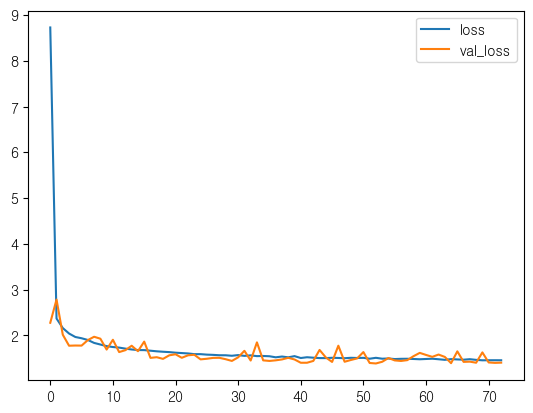

In [38]:
# 결과 시각화
plt.plot(hist.history['loss'])
plt.plot(hist.history['val_loss'])
plt.legend(['loss','val_loss'])
plt.show()

In [39]:
# 평가
scores = model_keras.evaluate(X_train, y_train)
print(scores)

scores = model_keras.evaluate(X_test, y_test)
print(scores)

4138/4138 [==============================] - 4s 871us/step - loss: 1.3771 - mse: 1.3771 - mae: 0.7891
[1.377102255821228, 1.377102255821228, 0.7891407012939453]
1035/1035 [==============================] - 1s 833us/step - loss: 1.3635 - mse: 1.3635 - mae: 0.7880
[1.3635467290878296, 1.3635467290878296, 0.7880265712738037]


In [40]:
from sklearn.metrics import r2_score

pred = model_keras.predict(X_test)
r2_score(y_test, pred)

1035/1035 [==============================] - 1s 681us/step


0.9716890778033132

In [41]:
rms = np.sqrt(model_keras.evaluate(X_train, y_train)[1])

4138/4138 [==============================] - 3s 772us/step - loss: 1.3771 - mse: 1.3771 - mae: 0.7891


In [42]:
print("데이터셋 정확도 :", r2_score(y_test, pred))
print("오차 :", rms)

데이터셋 정확도 : 0.9716890778033132
오차 : 1.1735000024802846


In [ ]:
'''
OLS               : 99.8%
LinearRegression  : 85.5%
의사결정나무       : 84.8%
SVM               : 98.6%
랜덤포레스트       : 99.2%
인공신경망         : 97.2%
'''

# 결론

In [ ]:
# 정확도는 OLS가 가장 높지만 오차를 가만한다면 가장 좋은 모델은 랜덤포레스트

In [43]:
import joblib

final_model = final_model_forest_reg
joblib.dump(final_model, 'c:/football_rating/model/final_model.model')

['c:/football_rating/model/final_model.model']